In [75]:
import pandas as pd
import numpy as np
import datetime as dt
from numpy import ones,vstack
from numpy.linalg import lstsq
import missingno as msno
import itertools

# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Dense, Activation, Dropout, LSTM, Conv1D, GRU
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
import tensorflow.keras.backend as K

# Data Visualizations
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.patches as mpatches
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

# Math & Stats
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedKFold
from sklearn.ensemble import StackingRegressor
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.preprocessing import StandardScaler, MinMaxScaler,RobustScaler, PowerTransformer
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report, f1_score, recall_score
import statsmodels.api as sm
import statsmodels.formula.api as smf
from scipy import stats

# Set seaborn theme as default
sns.set()

# Import custom utility funciton 
import _data_processor as dp
import _visualize as viz
import _predict_model as pm
import _trade_simulation as tm

ModuleNotFoundError: No module named 'statsmodels.api'

# 1. Load Data

In [2]:
# Read CSV - IDX30 Historical Data
df = pd.read_csv('dataset/LQ45_20200712.csv')
df['Date'] = pd.to_datetime(df['Date'], format='%d/%m/%Y')
df = df.set_index('Date').sort_index().rename(columns={"Price": "Close"})
df.drop(['Volume'],axis=1,inplace=True)

In [3]:
# read IDX30 data
IDX30 = pd.read_csv('dataset/IDX30_20200712.csv')
IDX30['Date'] = pd.to_datetime(IDX30['Date'], format='%d/%m/%Y')
IDX30 = IDX30.set_index('Date').sort_index().rename(columns={"Price": "IDX30"})

# read IHSG data
IHSG = pd.read_csv('dataset/IHSG_20200712.csv')
IHSG['Date'] = pd.to_datetime(IHSG['Date'], format='%d/%m/%Y')
IHSG = IHSG.set_index('Date').sort_index().rename(columns={"Price": "IHSG"})

IDX30.replace(0, np.nan, inplace=True)
IDX30['Volume'] = IDX30['Volume']/1000000000
IDX30.loc[IDX30.Volume > 13, 'Volume'] = np.nan

date_arr = IDX30.reset_index().Date
date_diff = ((np.diff(date_arr).astype('timedelta64[D]') / np.timedelta64(1, 'D'))- 1) / 4
IDX30['daysoff_backward'] = np.insert(date_diff, 0, 0)
IDX30['daysoff_forward'] = IDX30['daysoff_backward'].shift(-20)

IDX30 = IDX30[['IDX30','Volume']]
IHSG = IHSG[['IHSG']]

In [4]:
# read EIDO data
EIDO = pd.read_csv('dataset/EIDO_20200712.csv')
EIDO['Date'] = pd.to_datetime(EIDO['Date'], format='%d/%m/%Y')
EIDO = EIDO.set_index('Date').sort_index().rename(columns={"Price": "EIDO"})

# read SPY data
SPY = pd.read_csv('dataset/SPY_20200712.csv')
SPY['Date'] = pd.to_datetime(SPY['Date'], format='%d/%m/%Y')
SPY = SPY.set_index('Date').sort_index().rename(columns={"Price": "SPY"})

SPY = SPY[['SPY']]#.resample('D').mean().shift(1).fillna(method='ffill')
EIDO = EIDO[['EIDO']]#.resample('D').mean().shift(1).fillna(method='ffill')

In [5]:
# read USDIDR data
USDIDR = pd.read_csv('dataset/USDIDR_20200712.csv')
USDIDR['Date'] = pd.to_datetime(USDIDR['Date'], format='%d/%m/%Y')
USDIDR = USDIDR.set_index('Date').sort_index().rename(columns={"Price": "USDIDR"})

# read DXY data
DXY = pd.read_csv('dataset/DXY_20201512.csv')
DXY['Date'] = pd.to_datetime(DXY['Date'], format='%d/%m/%Y')
DXY = DXY.set_index('Date').sort_index().rename(columns={"Price": "DXY"})

DXY = DXY[['DXY']]
USDIDR = USDIDR[['USDIDR']]

In [6]:
df = df.merge(SPY, how='outer', left_index=True, right_index=True).copy()
df = df.merge(EIDO, how='outer', left_index=True, right_index=True).copy()

In [7]:
df = df.merge(IHSG, how='left', left_index=True, right_index=True).copy()
df = df.merge(IDX30, how='left', left_index=True, right_index=True).copy()

In [8]:
df = df.merge(USDIDR, how='left', left_index=True, right_index=True).copy()
df = df.merge(DXY, how='left', left_index=True, right_index=True).copy()

In [9]:
df

,Close,Open,High,Low,SPY,EIDO,IHSG,IDX30,Volume,USDIDR,DXY
Date,,,,,,,,,,,
2000-11-07,81.43,79.74,81.43,79.74,NaN,NaN,421.03,NaN,NaN,NaN,NaN
2000-11-08,83.07,81.40,83.86,80.64,NaN,NaN,426.08,NaN,NaN,NaN,NaN
2000-11-09,82.19,82.90,83.67,81.64,NaN,NaN,421.47,NaN,NaN,NaN,NaN
2000-11-10,83.76,82.18,83.76,81.79,NaN,NaN,426.97,NaN,NaN,NaN,NaN
2000-11-13,83.26,83.72,83.90,82.31,NaN,NaN,423.66,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
2020-12-01,904.83,890.15,908.57,879.50,366.02,22.50,5724.74,491.00,1.90,14100.0,91.31
2020-12-02,922.36,912.68,922.36,905.94,366.79,22.75,5813.99,499.80,1.71,14090.0,91.12
2020-12-03,921.18,927.29,929.72,917.16,366.69,22.72,5822.94,498.88,1.48,14100.0,90.71


# 2. Wrangle Data

In [10]:
# Resample Date to fill missing date
df = df.resample('D').mean()

In [11]:
# Interpolate Close and Volume Values
df['Close'] = df['Close'].interpolate()
df['Open'] = df['Open'].interpolate()
df['High'] = df['High'].interpolate()
df['Low'] = df['Low'].interpolate()
df['Volume'] = df['Volume'].interpolate()
df['IDX30'] = df['IDX30'].interpolate()
df['IHSG'] = df['IHSG'].interpolate()
df['EIDO'] = df['EIDO'].interpolate()
df['SPY'] = df['SPY'].interpolate()
df['USDIDR'] = df['USDIDR'].interpolate()
df['DXY'] = df['DXY'].interpolate()

<AxesSubplot:>

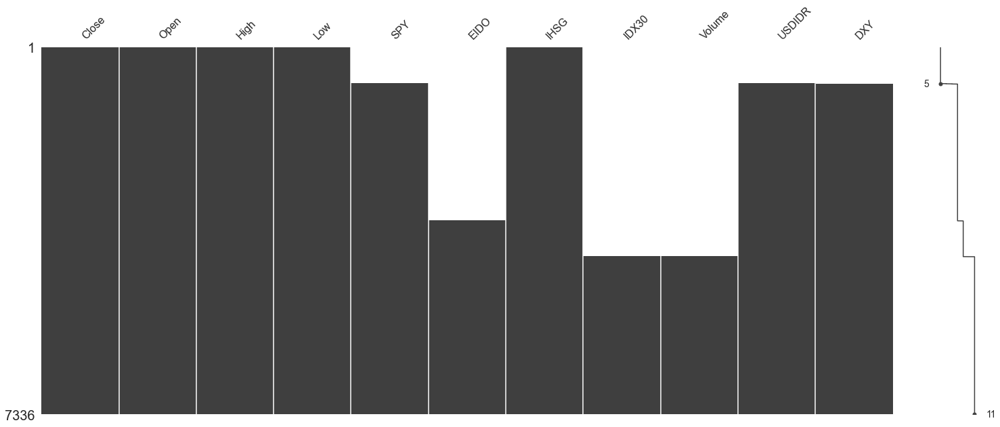

In [12]:
msno.matrix(df)

In [13]:
# Remove saturday and sunday data
df['day_of_week'] = df.index.dayofweek + 1
df = df[df['day_of_week'] < 6].copy()
df.drop(columns=['day_of_week'],inplace=True)

In [14]:
df = df[df['IDX30']==df['IDX30']].copy()

In [15]:
# Best ma parameter combination
SLOW_MA = 6
FAST_MA = 6
EIDO_SPY_SLOW_MA = 6
EIDO_SPY_FAST_MA = 6
IDX30_IHSG_SLOW_MA = 7
IDX30_IHSG_FAST_MA = 5
Volume_SLOW_MA = 10
Volume_FAST_MA = 6

In [16]:
# Calculate gradient
df['EIDO'] = 100*df['EIDO']/df['EIDO'][0]
df['SPY'] = 100*df['SPY']/df['SPY'][0]
df['EIDO_SPY_diff'] = df['EIDO'] - df['SPY']
df['EIDO_SPY_ma'] = df['EIDO_SPY_diff'].rolling(7).mean()
# df['EIDO_SPY_grad'] = df['EIDO_SPY_ma'].diff(7)

df['EIDO_SPY_3'] = df['EIDO_SPY_diff'].rolling(FAST_MA).mean()
df['EIDO_SPY_11'] = df['EIDO_SPY_diff'].rolling(SLOW_MA).mean().shift(FAST_MA)

df['EIDO_SPY_grad'] = df['EIDO_SPY_diff'].rolling(EIDO_SPY_FAST_MA).mean() - df['EIDO_SPY_diff'].rolling(EIDO_SPY_SLOW_MA).mean().shift(EIDO_SPY_FAST_MA)

# Calculate EIDO vs SPY
df['EIDO_grad'] = df['EIDO'].rolling(FAST_MA).mean() - df['EIDO'].rolling(SLOW_MA).mean().shift(FAST_MA)
df['SPY_grad'] = df['SPY'].rolling(FAST_MA).mean() - df['SPY'].rolling(SLOW_MA).mean().shift(FAST_MA)
# df['EIDO_SPY'] = df['EIDO'] - df['SPY']

In [17]:
# Calculate gradient
df['IDX30'] = 100*df['IDX30']/df['IDX30'][0]
df['IHSG'] = 100*df['IHSG']/df['IHSG'][0]
df['IDX30_IHSG_diff'] = df['IDX30'] - df['IHSG']
df['IDX30_IHSG_ma'] = df['IDX30_IHSG_diff'].rolling(7).mean()
# df['IDX30_IHSG_grad'] = df['IDX30_IHSG_ma'].diff(7)

df['IDX30_IHSG_grad'] = df['IDX30_IHSG_diff'].rolling(IDX30_IHSG_FAST_MA).mean() - df['IDX30_IHSG_diff'].rolling(IDX30_IHSG_SLOW_MA).mean().shift(IDX30_IHSG_FAST_MA)

# Calculate IHSG vs IDX30
df['IDX30_grad'] = df['IDX30'].rolling(FAST_MA).mean() - df['IDX30'].rolling(SLOW_MA).mean().shift(FAST_MA)
df['IHSG_grad'] = df['IHSG'].rolling(FAST_MA).mean() - df['IHSG'].rolling(SLOW_MA).mean().shift(FAST_MA)

In [18]:
# Calculate USDIDR/DXY gradient
df['DXY'] = 100*df['DXY']/df['DXY'][0]
df['USDIDR'] = 100*df['USDIDR']/df['USDIDR'][0]
df['DXY_USDIDR_diff'] = df['DXY'] - df['USDIDR']
df['DXY_USDIDR_ma'] = df['DXY_USDIDR_diff'].rolling(7).mean()
# df['DXY_USDIDR_grad'] = df['DXY_USDIDR_ma'].diff(7)

df['DXY_USDIDR_grad'] = df['DXY_USDIDR_diff'].rolling(FAST_MA).mean() - df['DXY_USDIDR_diff'].rolling(SLOW_MA).mean().shift(FAST_MA)
df['DXY_grad'] = df['DXY'].rolling(FAST_MA).mean() - df['DXY'].rolling(SLOW_MA).mean().shift(FAST_MA)
df['USDIDR_grad'] = df['USDIDR'].rolling(FAST_MA).mean() - df['USDIDR'].rolling(SLOW_MA).mean().shift(FAST_MA)

In [19]:
# Calculate momentum USDIDR and DXY
df['DXY_momentum'] = dp.momentum_transformation(df, 'DXY', ma_span=20)
df['USDIDR_momentum'] = dp.momentum_transformation(df, 'USDIDR', ma_span=20)
df['DXY-USDIDR'] = df['DXY_momentum'] - df['USDIDR_momentum']

In [20]:
df['Volume_ma'] = df['Volume'].rolling(14).mean()
df['Volume_grad'] = df['Volume'].rolling(Volume_FAST_MA).mean() - df['Volume'].rolling(Volume_SLOW_MA).mean().shift(Volume_FAST_MA)

In [21]:
fig = make_subplots(rows=2, cols=1,shared_xaxes=True,vertical_spacing=0.04)

fig.add_trace(go.Scatter(
            y=df['DXY'],
            x=df.index,
            line=dict(color='blue'),
            name='DXY'
        ),
    row=1, col=1)

fig.add_trace(go.Scatter(
            y=df['USDIDR'],
            x=df.index,
            line=dict(color='firebrick'),
            name='USDIDR'
        ),
    row=1, col=1)

fig.add_trace(go.Scatter(
            y=df['DXY_USDIDR_ma'].rolling(7).mean(),
            x=df.index,
            line=dict(color='purple'),
            name='DXY_USDIDR_ma'
        ),
    row=2, col=1)

fig.add_trace(go.Scatter(
            y=df['DXY_USDIDR_grad'].rolling(7).mean(),
            x=df.index,
            line=dict(color='green'),
            name='DXY_USDIDR_grad'
        ),
    row=2, col=1)

fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
),height=800, width=1000, title_text="IDX30 vs IHSG, Price Difference and Gradient")


fig.show()

In [22]:
fig = make_subplots(rows=2, cols=1,shared_xaxes=True,vertical_spacing=0.04)

fig.add_trace(go.Scatter(
            y=df['DXY_USDIDR_diff'],
            x=df.index,
            line=dict(color='blue'),
            name='DXY_USDIDR_diff'
        ),
    row=1, col=1)

fig.add_trace(go.Scatter(
            y=df['IHSG'],
            x=df.index,
            line=dict(color='firebrick'),
            name='IHSG'
        ),
    row=1, col=1)

fig.add_trace(go.Scatter(
            y=df['IDX30_IHSG_diff'].rolling(7).mean(),
            x=df.index,
            line=dict(color='purple'),
            name='IDX30_IHSG_diff'
        ),
    row=2, col=1)

fig.add_trace(go.Scatter(
            y=df['IDX30_IHSG_grad'].rolling(7).mean(),
            x=df.index,
            line=dict(color='green'),
            name='IDX30_IHSG_grad'
        ),
    row=2, col=1)

fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
),height=800, width=1000, title_text="IDX30 vs IHSG, Price Difference and Gradient")


fig.show()

In [23]:
def hampel(vals_orig, k=7, t0=3):
    '''
    vals: pandas series of values from which to remove outliers
    k: size of window (including the sample; 7 is equal to 3 on either side of value)
    '''
    
    #Make copy so original not edited
    vals = vals_orig.copy()
    
    #Hampel Filter
    L = 1.4826
    rolling_median = vals.rolling(window=k, center=True).median()
    MAD = lambda x: np.median(np.abs(x - np.median(x)))
    rolling_MAD = vals.rolling(window=k, center=True).apply(MAD)
    threshold = t0 * L * rolling_MAD
    difference = np.abs(vals - rolling_median)
    
    '''
    Perhaps a condition should be added here in the case that the threshold value
    is 0.0; maybe do not mark as outlier. MAD may be 0.0 without the original values
    being equal. See differences between MAD vs SDV.
    '''
    
    outlier_idx = difference > threshold
    vals[outlier_idx] = rolling_median[outlier_idx] 
    return(vals)

In [24]:
volume_ts = pd.Series(df['Volume'].values)
hampel_volume_ts = hampel(volume_ts,k=10,t0=2)
df['Volume_filtered'] = hampel_volume_ts.values.copy()
df['Volume_ma'] = df['Volume_filtered'].rolling(14).mean()

In [25]:
fig = make_subplots(rows=1, cols=1,shared_xaxes=True,vertical_spacing=0.04)

fig.add_trace(go.Scatter(
            y=volume_ts,
            name='Volume'
        ),
    row=1, col=1)

fig.add_trace(go.Scatter(
            y=hampel_volume_ts,
            name='Volume - Hampel Filter - window=10 - sigma=2'
        ),
    row=1, col=1)

fig.add_trace(go.Scatter(
            y=df['Volume_ma'],
            name='Volume Moving Average'
        ),
    row=1, col=1)

fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
),height=600, width=1000)

fig.show()

In [26]:
fig = px.histogram(df, x="Volume_ma",
                   marginal="box", # or violin, rug
                   hover_data=df.columns)
fig.show()

### 2.3 Determine Target Variables
In this section, we will determine the most optimal target for our machine learning model. Before feeding our data to LSTM model, we must make sure that the data is stationary meaning the statistics of our target variable dont change over time. Stationarizing is done by scaling the target variable using StandardScaler()

In [27]:
MA_PERIOD = 5
FUTURE_DAYS = 3

In [28]:
df['momentum'] = dp.momentum_transformation(df, 'Close', ma_span=MA_PERIOD, normalized=False)
df['1day_price_change'] = df['Close'].pct_change() * 100
df['intra_change'] = 100*(df['Close']-df['Open'])/df['Open']
df['price_volatility'] = df['1day_price_change'].rolling(10).std()
df['linear_series'] = (df.reset_index().index + 1000) / 1000
df['target'] = df['Close'].pct_change(periods=FUTURE_DAYS).shift(-(FUTURE_DAYS-1)) * 100

In [29]:
# Volume hampel filtered
# df['Volume'] = hampel(volume_ts,k=20,t0=3)

In [30]:
fig = make_subplots(rows=2, cols=1,shared_xaxes=True,vertical_spacing=0.04)

fig.add_trace(go.Scatter(
            y=df['Volume_ma'],
            x=df.index,
            line=dict(color='blue'),
            name='Volume_ma'
        ),
    row=1, col=1)

fig.add_trace(go.Scatter(
            y=df['linear_series'],
            x=df.index,
            line=dict(color='firebrick'),
            name='linear_series'
        ),
    row=2, col=1)

fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
),height=800, width=1000)

fig.show()

### 2.4 Train Test Split

In [31]:
df.isna().sum()

Close                 0
Open                  0
High                  0
Low                   0
SPY                   0
EIDO                  0
IHSG                  0
IDX30                 0
Volume                0
USDIDR                0
DXY                   0
EIDO_SPY_diff         0
EIDO_SPY_ma           6
EIDO_SPY_3            5
EIDO_SPY_11          11
EIDO_SPY_grad        11
EIDO_grad            11
SPY_grad             11
IDX30_IHSG_diff       0
IDX30_IHSG_ma         6
IDX30_IHSG_grad      11
IDX30_grad           11
IHSG_grad            11
DXY_USDIDR_diff       0
DXY_USDIDR_ma         6
DXY_USDIDR_grad      11
DXY_grad             11
USDIDR_grad          11
DXY_momentum         19
USDIDR_momentum      19
DXY-USDIDR           19
Volume_ma            13
Volume_grad          15
Volume_filtered       0
momentum              4
1day_price_change     1
intra_change          0
price_volatility     10
linear_series         0
target                3
dtype: int64

In [32]:
df = df.dropna()

### 2.5 Remove Outliers

In [33]:
# Determine mean and standard deviation
MEAN = np.mean(df['target'].values)
STD = np.std(df['target'].values)
print('Mean: ', MEAN)
print('STD: ', STD)

Mean:  0.06968521192214656
STD:  2.3073312870270306


In [34]:
fig = px.histogram(df, x="target",
                   marginal="box", # or violin, rug
                   hover_data=df.columns)
fig.show()

In [36]:
scaler = StandardScaler()
transformer = scaler.fit(df['target'].values.reshape(-1, 1))
df['target'] = transformer.transform(df['target'].values.reshape(-1, 1))
# df['target'] = df['target']/2
# df['target'] = df['target'] / (np.std(df['target']) * 4)

In [37]:
# Inverse scale minimum and maximum to determine target
transformer.inverse_transform([0.15,-0.15])

array([ 0.39567156, -0.17468855])

In [38]:
fig = px.histogram(df, x="target",
                   marginal="box", # or violin, rug
                   hover_data=df.columns)
fig.show()

### 2.6 Train test split

In [39]:
df_train = df[df.index < '2020-01-01'].copy()
df_test = df[(df.index >= '2019-01-01') & (df.index <= '2019-12-31')].copy()

In [40]:
fig = px.histogram(df_test, x="target",
                   marginal="box", # or violin, rug
                   hover_data=df.columns)
fig.show()

In [41]:
print(df_train.shape)
print(df_test.shape)

(1966, 40)
(261, 40)


In [42]:
# Model parameters
input_variables = ['momentum','IDX30_IHSG_grad','EIDO_SPY_grad','Volume_grad']
target_variables = 'target'
neurons = 100
input_timesteps = 20
output_timesteps = 1
epochs = 100
validation_split = 0.1
batch_size=df_train.shape[0]

In [43]:
pd.DataFrame(data={'Parameters':['Input Variables',
                                 'Target Variables',
                                 'Input Timesteps',
                                 'Output Timesteps', 
                                 'Forward Predictions', 
                                 'LSTM Neurons','Epochs',
                                 'Batch Size',
                                 'Validation Split'],
                    'Value':[['momentum','IDX30_IHSG_grad','EIDO_SPY_grad','total_val_grad','dom_val_ma','for_flow_ma'],
                                'LQ45 3-day price change',
                                '{} Days'.format(input_timesteps),
                                '{}'.format(output_timesteps),
                                '{} Days'.format(FUTURE_DAYS),
                                80,epochs,batch_size,"{0:.0%}".format(validation_split)]}).style.hide_index()

Parameters,Value
Input Variables,"['momentum', 'IDX30_IHSG_grad', 'EIDO_SPY_grad', 'total_val_grad', 'dom_val_ma', 'for_flow_ma']"
Target Variables,LQ45 3-day price change
Input Timesteps,20 Days
Output Timesteps,1
Forward Predictions,3 Days
LSTM Neurons,80
Epochs,100
Batch Size,1966
Validation Split,10%


In [44]:
pd.DataFrame(data={'Parameters': ['Start Date','End Date','Data Points'], 
                   'Training Data': [df_train.index.min(), df_train.index.max(), '{} Days'.format(len(df_train))],
                   'Testing Data': [df_test.index.min(), df_test.index.max(), '{} Days'.format(len(df_test))]}).style.hide_index()

Parameters,Training Data,Testing Data
Start Date,2012-05-21 00:00:00,2019-01-01 00:00:00
End Date,2019-12-31 00:00:00,2019-12-31 00:00:00
Data Points,1966 Days,261 Days


<AxesSubplot:>

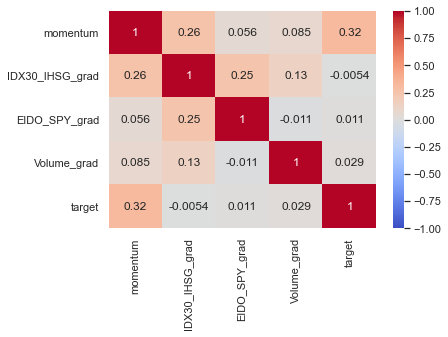

In [45]:
corrmat = df[input_variables+[target_variables]].corr()
sns.heatmap(corrmat, annot = True, vmin=-1, vmax=1, cmap= 'coolwarm')

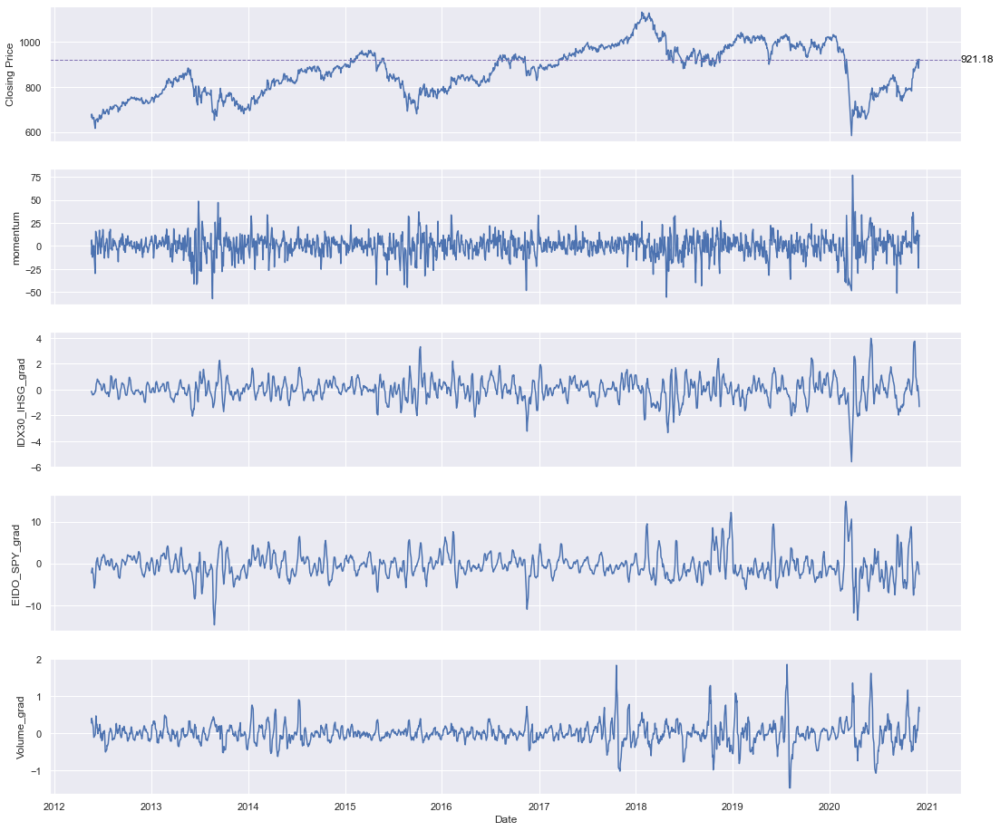

In [46]:
fig, ax = plt.subplots(len(input_variables)+1, 1, sharex=True, figsize=[18, 4*len(input_variables)])
    
# Closing price chart
sns.lineplot(data=df['Close'], ax=ax[0])
last_closing_price = df['Close'][-1]
ax[0].set_ylabel('Closing Price')
ax[0].axhline(last_closing_price, ls='--',linewidth=1, color='m')
ax[0].annotate(last_closing_price.round(2),
               xy=(1,last_closing_price),
               xycoords=('axes fraction','data'),
               ha='left',
               va='center',
               color='black')
ax[0].grid(True)

for index, column in enumerate(input_variables):
    sns.lineplot(data=df[column], ax=ax[index+1])
    ax[index+1].grid(True)

# 3. Build and Train LSTM Model

Long Short-Term Memory networks – usually just called “LSTMs” – are a special kind of RNN, capable of learning long-term dependencies. They were introduced by Hochreiter & Schmidhuber (1997), and were refined and popularized by many people in following work. They work tremendously well on a large variety of problems, and are now widely used.

LSTMs are explicitly designed to avoid the long-term dependency problem. Remembering information for long periods of time is practically their default behavior, not something they struggle to learn!

All recurrent neural networks have the form of a chain of repeating modules of neural network. In standard RNNs, this repeating module will have a very simple structure, such as a single tanh layer.

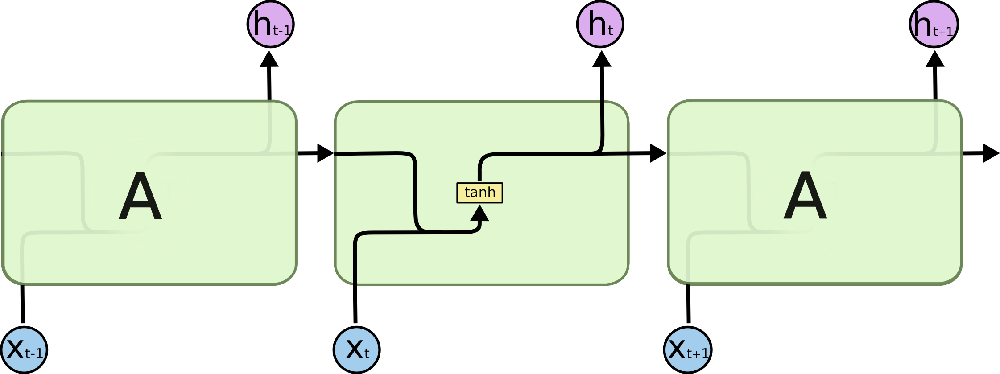

LSTMs also have this chain like structure, but the repeating module has a different structure. Instead of having a single neural network layer, there are four, interacting in a very special way.

A LSTM neural network.
The repeating module in an LSTM contains four interacting layers.
Don’t worry about the details of what’s going on. We’ll walk through the LSTM diagram step by step later. For now, let’s just try to get comfortable with the notation we’ll be using.


In the above diagram, each line carries an entire vector, from the output of one node to the inputs of others. The pink circles represent pointwise operations, like vector addition, while the yellow boxes are learned neural network layers. Lines merging denote concatenation, while a line forking denote its content being copied and the copies going to different locations.

In [47]:
X_train, y_train = dp.generate_batch(df_train, 
                                      input_timesteps,
                                      output_timesteps,
                                      input_variables,
                                      target_variables)
dates = df_train[(input_timesteps+output_timesteps-1):].index

In [48]:
print('X_train shape: {}'.format(X_train.shape))
print('y_train shape: {}'.format(y_train.shape))

X_train shape: (1946, 20, 4)
y_train shape: (1946, 1)


In [49]:
def sign_accuracy(true,pred):
    return K.mean(K.equal(K.sign(true), K.sign(pred)))

In [50]:
def sign_penalty(true,pred):
    sign = tf.math.sign(true)
    loss_magnitude = sign * (true - pred)
    loss = tf.where(tf.less(loss_magnitude,0), tf.square(true - pred), 0.1*tf.square(true - pred))
    return tf.reduce_mean(loss,axis=-1)

In [51]:
# Build LSTM Model using Tensorflow
model = tf.keras.Sequential()
model.add(GRU(neurons, activation='linear', input_shape=(X_train.shape[1], X_train.shape[2])))
model.add(Dense(output_timesteps, activation='tanh'))
model.compile(optimizer='adam', loss='squared_hinge', metrics=[sign_accuracy])
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
gru (GRU)                    (None, 100)               31800     
_________________________________________________________________
dense (Dense)                (None, 1)                 101       
Total params: 31,901
Trainable params: 31,901
Non-trainable params: 0
_________________________________________________________________


In [52]:
# callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=13)
model_path = 'lstm_momemtum_v1.6.hdf5'
mcp_save = ModelCheckpoint(model_path, save_best_only=True, monitor='val_sign_accuracy', mode='max',verbose=1)

history = model.fit(
    X_train,
    y_train,
    epochs=epochs,
    batch_size=len(X_train),
    validation_split=validation_split,
    verbose = 2, 
    shuffle=False,
    callbacks=[mcp_save]
)

Epoch 1/100

Epoch 00001: val_sign_accuracy improved from -inf to 0.46667, saving model to lstm_momemtum_v1.6.hdf5
1/1 - 0s - loss: 1.1714 - sign_accuracy: 0.5060 - val_loss: 1.3240 - val_sign_accuracy: 0.4667
Epoch 2/100

Epoch 00002: val_sign_accuracy improved from 0.46667 to 0.50769, saving model to lstm_momemtum_v1.6.hdf5
1/1 - 0s - loss: 1.0978 - sign_accuracy: 0.5403 - val_loss: 1.2931 - val_sign_accuracy: 0.5077
Epoch 3/100

Epoch 00003: val_sign_accuracy did not improve from 0.50769
1/1 - 0s - loss: 1.0780 - sign_accuracy: 0.5523 - val_loss: 1.2411 - val_sign_accuracy: 0.4974
Epoch 4/100

Epoch 00004: val_sign_accuracy did not improve from 0.50769
1/1 - 0s - loss: 1.0450 - sign_accuracy: 0.5705 - val_loss: 1.1975 - val_sign_accuracy: 0.4923
Epoch 5/100

Epoch 00005: val_sign_accuracy did not improve from 0.50769
1/1 - 0s - loss: 1.0148 - sign_accuracy: 0.5682 - val_loss: 1.1153 - val_sign_accuracy: 0.4923
Epoch 6/100

Epoch 00006: val_sign_accuracy did not improve from 0.50769


Epoch 48/100

Epoch 00048: val_sign_accuracy did not improve from 0.61026
1/1 - 0s - loss: 0.8602 - sign_accuracy: 0.6299 - val_loss: 0.9772 - val_sign_accuracy: 0.5692
Epoch 49/100

Epoch 00049: val_sign_accuracy did not improve from 0.61026
1/1 - 0s - loss: 0.8584 - sign_accuracy: 0.6276 - val_loss: 0.9819 - val_sign_accuracy: 0.5692
Epoch 50/100

Epoch 00050: val_sign_accuracy did not improve from 0.61026
1/1 - 0s - loss: 0.8567 - sign_accuracy: 0.6294 - val_loss: 0.9835 - val_sign_accuracy: 0.5744
Epoch 51/100

Epoch 00051: val_sign_accuracy did not improve from 0.61026
1/1 - 0s - loss: 0.8549 - sign_accuracy: 0.6294 - val_loss: 0.9835 - val_sign_accuracy: 0.5744
Epoch 52/100

Epoch 00052: val_sign_accuracy did not improve from 0.61026
1/1 - 0s - loss: 0.8530 - sign_accuracy: 0.6311 - val_loss: 0.9843 - val_sign_accuracy: 0.5692
Epoch 53/100

Epoch 00053: val_sign_accuracy did not improve from 0.61026
1/1 - 0s - loss: 0.8512 - sign_accuracy: 0.6288 - val_loss: 0.9861 - val_sign_acc

Epoch 97/100

Epoch 00097: val_sign_accuracy did not improve from 0.61026
1/1 - 0s - loss: 0.7230 - sign_accuracy: 0.7127 - val_loss: 1.2416 - val_sign_accuracy: 0.5077
Epoch 98/100

Epoch 00098: val_sign_accuracy did not improve from 0.61026
1/1 - 0s - loss: 0.7155 - sign_accuracy: 0.7070 - val_loss: 1.2324 - val_sign_accuracy: 0.5128
Epoch 99/100

Epoch 00099: val_sign_accuracy did not improve from 0.61026
1/1 - 0s - loss: 0.7152 - sign_accuracy: 0.7076 - val_loss: 1.2767 - val_sign_accuracy: 0.4974
Epoch 100/100

Epoch 00100: val_sign_accuracy did not improve from 0.61026
1/1 - 0s - loss: 0.7071 - sign_accuracy: 0.7156 - val_loss: 1.3040 - val_sign_accuracy: 0.4821


In [53]:
# plot training history
hist = pd.DataFrame.from_dict(history.history)
fig = go.Figure()

fig.add_trace(go.Scatter(y=hist['sign_accuracy'],line=dict(color='blue'),name='train'))
fig.add_trace(go.Scatter(y=hist['val_sign_accuracy'],line=dict(color='firebrick'),name='val'))

fig.update_layout(
    title="Train and Validation Accuracy per epoch",
    xaxis_title="Epoch",
    yaxis_title="Accuracy")
fig.show()

In [54]:
# plot training history
hist = pd.DataFrame.from_dict(history.history)
fig = go.Figure()

fig.add_trace(go.Scatter(y=hist['loss'],line=dict(color='blue'),name='train_loss'))
fig.add_trace(go.Scatter(y=hist['val_loss'],line=dict(color='firebrick'),name='val_loss'))

fig.update_layout(
    title="Train and Validation Loss per epoch",
    xaxis_title="Epoch",
    yaxis_title="Loss")
fig.show()

In [55]:
# Restore the weights of best model
new_model = tf.keras.models.load_model(model_path, compile=False )

In [56]:
def generate_prediction(m, X, y, dates):
    pred = m.predict(X)[:,0]
    true = y[:,0]
    train_result = pm.bundle_predicted_actual(true,pred)
    train_result['mse'] = np.abs(train_result['true'] - train_result['pred']).rolling(7).sum()
    train_result['squared_hinge'] = 1 - train_result['true'] * train_result['pred']
    train_result.loc[train_result['squared_hinge'] < 0,'squared_hinge'] = 0
    train_result['squared_hinge'] = train_result['squared_hinge']**2
    train_result['rolling_error'] = train_result['squared_hinge'].rolling(7).mean()
    train_result['date'] = dates
    train_result['date_str'] = train_result['date'].dt.strftime('%Y-%m-%d')
    train_result['date_to_val'] = train_result['date'].map(pd.Series(data=np.arange(len(train_result)), 
                                                                     index=train_result['date'].values).to_dict())
    return pred,true,train_result

pred,true,train_result = generate_prediction(new_model,X_train,y_train,dates)

In [57]:
fig = px.histogram(train_result, x="squared_hinge",
                   marginal="box")
fig.show()

In [58]:
fig = make_subplots(rows=2, cols=1,shared_xaxes=True,vertical_spacing=0.04)

fig.add_trace(
    go.Scatter(y=train_result['true'],x=train_result['date'],line=dict(color='blue'),name='Actual'),
    row=2,col=1)

fig.add_trace(
    go.Scatter(y=train_result['pred'],x=train_result['date'],line=dict(color='firebrick'),name='Prediction'),
    row=2,col=1)

fig.add_trace(
    go.Scatter(y=train_result['rolling_error'],x=train_result['date'],line=dict(color='purple'),name='Error'),
    row=1,col=1)

fig.update_layout(
    legend=dict(yanchor="top",y=0.99,xanchor="left",x=0.01),
    height=600, 
    width=1000, 
    title_text="Training - Actual vs Prediction and Rolling Error")
fig.show()

# Retrain Model without Outliers

In [78]:
target = train_result['squared_hinge']
no_outliers =  (target < 2.7)

X_train = X_train[no_outliers]
y_train = y_train[no_outliers]
dates = dates[no_outliers]

model_path2 = 'gru_best.hdf5'
mcp_save2 = ModelCheckpoint(model_path2, save_best_only=True, monitor='val_sign_accuracy', mode='max',verbose=1)
new_model.compile(optimizer='adam', loss='squared_hinge', metrics=[sign_accuracy])

history = new_model.fit(
    X_train,
    y_train,
    epochs=epochs,
    batch_size=len(X_train),
    validation_split=validation_split,
    verbose = 2, 
    shuffle=True,
    callbacks=[mcp_save2]
)

new_model2 = tf.keras.models.load_model(model_path2, compile=False )

pred,true,train_result = generate_prediction(new_model2,X_train,y_train,dates)

Epoch 1/100

Epoch 00001: val_sign_accuracy improved from -inf to 0.58031, saving model to gru_best.hdf5
1/1 - 0s - loss: 0.9181 - sign_accuracy: 0.5776 - val_loss: 1.0396 - val_sign_accuracy: 0.5803
Epoch 2/100

Epoch 00002: val_sign_accuracy did not improve from 0.58031
1/1 - 0s - loss: 1.0106 - sign_accuracy: 0.5799 - val_loss: 0.9794 - val_sign_accuracy: 0.5751
Epoch 3/100

Epoch 00003: val_sign_accuracy improved from 0.58031 to 0.60104, saving model to gru_best.hdf5
1/1 - 0s - loss: 0.9196 - sign_accuracy: 0.5926 - val_loss: 0.9445 - val_sign_accuracy: 0.6010
Epoch 4/100

Epoch 00004: val_sign_accuracy improved from 0.60104 to 0.62694, saving model to gru_best.hdf5
1/1 - 0s - loss: 0.9355 - sign_accuracy: 0.5817 - val_loss: 0.9616 - val_sign_accuracy: 0.6269
Epoch 5/100

Epoch 00005: val_sign_accuracy did not improve from 0.62694
1/1 - 0s - loss: 0.9467 - sign_accuracy: 0.5638 - val_loss: 0.9725 - val_sign_accuracy: 0.5803
Epoch 6/100

Epoch 00006: val_sign_accuracy did not improv

Epoch 49/100

Epoch 00049: val_sign_accuracy did not improve from 0.62694
1/1 - 0s - loss: 0.8410 - sign_accuracy: 0.6382 - val_loss: 0.9654 - val_sign_accuracy: 0.5544
Epoch 50/100

Epoch 00050: val_sign_accuracy did not improve from 0.62694
1/1 - 0s - loss: 0.8394 - sign_accuracy: 0.6394 - val_loss: 0.9668 - val_sign_accuracy: 0.5596
Epoch 51/100

Epoch 00051: val_sign_accuracy did not improve from 0.62694
1/1 - 0s - loss: 0.8377 - sign_accuracy: 0.6399 - val_loss: 0.9674 - val_sign_accuracy: 0.5544
Epoch 52/100

Epoch 00052: val_sign_accuracy did not improve from 0.62694
1/1 - 0s - loss: 0.8359 - sign_accuracy: 0.6445 - val_loss: 0.9680 - val_sign_accuracy: 0.5492
Epoch 53/100

Epoch 00053: val_sign_accuracy did not improve from 0.62694
1/1 - 0s - loss: 0.8341 - sign_accuracy: 0.6434 - val_loss: 0.9699 - val_sign_accuracy: 0.5596
Epoch 54/100

Epoch 00054: val_sign_accuracy did not improve from 0.62694
1/1 - 0s - loss: 0.8323 - sign_accuracy: 0.6469 - val_loss: 0.9736 - val_sign_acc

Epoch 98/100

Epoch 00098: val_sign_accuracy did not improve from 0.62694
1/1 - 0s - loss: 0.6798 - sign_accuracy: 0.7409 - val_loss: 1.2193 - val_sign_accuracy: 0.5026
Epoch 99/100

Epoch 00099: val_sign_accuracy did not improve from 0.62694
1/1 - 0s - loss: 0.6738 - sign_accuracy: 0.7409 - val_loss: 1.2252 - val_sign_accuracy: 0.4974
Epoch 100/100

Epoch 00100: val_sign_accuracy did not improve from 0.62694
1/1 - 0s - loss: 0.6688 - sign_accuracy: 0.7467 - val_loss: 1.2206 - val_sign_accuracy: 0.5026


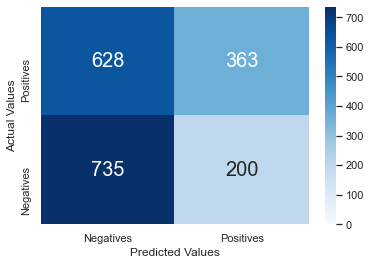

In [79]:
conf_matrix = confusion_matrix(train_result['true_bin'],train_result['pred_bin'])[::-1]
viz.display_confusion_matrix(conf_matrix, reverse_ylabel=True)

In [80]:
print(classification_report(train_result['true_bin'],train_result['pred_bin'], target_names=['Negatives','Positives']))

              precision    recall  f1-score   support

   Negatives       0.54      0.79      0.64       935
   Positives       0.64      0.37      0.47       991

    accuracy                           0.57      1926
   macro avg       0.59      0.58      0.55      1926
weighted avg       0.59      0.57      0.55      1926



In [81]:
fig = px.scatter(train_result, x="pred", y="true", color="squared_hinge", 
                 trendline="ols",
                 title="Training - Best Output",
                 width=800, height=800, hover_data=["date_str"])
fig.show()

ModuleNotFoundError: No module named 'statsmodels.api'

In [82]:
fig = make_subplots(rows=2, cols=1,shared_xaxes=True,vertical_spacing=0.04)

fig.add_trace(
    go.Scatter(y=train_result['true'],x=train_result['date'],line=dict(color='blue'),name='Actual'),
    row=2,col=1)

fig.add_trace(
    go.Scatter(y=train_result['pred'],x=train_result['date'],line=dict(color='firebrick'),name='Prediction'),
    row=2,col=1)

fig.add_trace(
    go.Scatter(y=train_result['rolling_error'],x=train_result['date'],line=dict(color='purple'),name='Error'),
    row=1,col=1)

fig.update_layout(
    legend=dict(yanchor="top",y=0.99,xanchor="left",x=0.01),
    height=600, 
    width=1000, 
    title_text="Training - Actual vs Prediction and Rolling Error")
fig.show()

## 4.3 Visualize test prediction result

###  Develop 3 kind of model:
    1. Varying training period (2019,2020,2021)
    2. Varying Input features
    3. Varying target scaler (StandardScaler(), tanh, log-normalization)
    4. Interpolate vs ffill()
    5. Explore using moving average as a percentage from start of t-20

In [83]:
# gru7_no_covid_n150_2 = tf.keras.models.load_model('gru7_no_covid_n150_2.hdf5', compile=False )

df_test = df[(df.index >= '2020-01-01') & (df.index < '2021-12-01')].copy()
# df_test = df[(df.index >= '2019-01-01') & (df.index < '2020-01-01')].copy()
# df_test = df[(df.index >= '2018-01-01') & (df.index < '2019-01-01')].copy()

In [84]:
X_test, y_test = dp.generate_batch(df_test, 
                                  input_timesteps,
                                  output_timesteps,
                                  input_variables,
                                  target_variables)

pred,true,test_result = generate_prediction(new_model,X_test,y_test,df_test.index[(input_timesteps+output_timesteps-1):])

<AxesSubplot:>

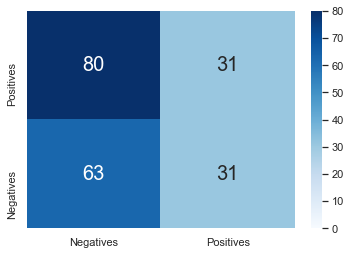

In [85]:
labels = ['Negatives','Positives']
conf_matrix = confusion_matrix(test_result['true_bin'],test_result['pred_bin'])[::-1]
sns.heatmap(conf_matrix, 
                annot=True, 
                cmap="Blues",
                fmt="d",vmin=0, 
                annot_kws={"size": 20}, 
                xticklabels = labels, 
                yticklabels= labels[::-1])

In [86]:
print(classification_report(test_result['pred_bin'], test_result['true_bin'], target_names=['Negatives','Positives']))

              precision    recall  f1-score   support

   Negatives       0.67      0.44      0.53       143
   Positives       0.28      0.50      0.36        62

    accuracy                           0.46       205
   macro avg       0.47      0.47      0.45       205
weighted avg       0.55      0.46      0.48       205



Text(30.453125, 0.5, 'Actual Values')

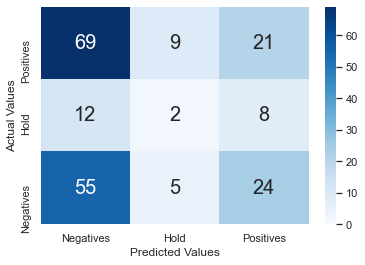

In [87]:
test_pred_ter = np.where(test_result['pred'] < -0.15,-1,np.where(test_result['pred'] > 0.15,1,0))
test_true_ter = np.where(test_result['true'] < -0.15,-1,np.where(test_result['true'] > 0.15,1,0))
conf_matrix = confusion_matrix(test_true_ter,test_pred_ter)[::-1]
labels = ['Negatives','Hold','Positives']
sns.heatmap(conf_matrix, 
                annot=True, 
                cmap="Blues",
                fmt="d",vmin=0, 
                annot_kws={"size": 20}, 
                xticklabels = labels, 
                yticklabels= labels[::-1])
plt.xlabel('Predicted Values', fontsize = 12) # x-axis label with fontsize 15
plt.ylabel('Actual Values', fontsize = 12)


In [88]:
print(classification_report(test_pred_ter, test_true_ter, target_names=['Negatives','Hold','Positives']))

              precision    recall  f1-score   support

   Negatives       0.65      0.40      0.50       136
        Hold       0.09      0.12      0.11        16
   Positives       0.21      0.40      0.28        53

    accuracy                           0.38       205
   macro avg       0.32      0.31      0.29       205
weighted avg       0.50      0.38      0.41       205



In [ ]:
fig = px.scatter(test_result, x="pred", y="true", color="squared_hinge", 
                 trendline="ols",
                 title="Test - Best Output",
                 width=800, height=800, hover_data=["date_str"])
fig.show()

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(
            y=test_result['true'],
            x=test_result['date'],
            line=dict(color='blue'),
            name='Actual'))
fig.add_trace(go.Scatter(
            y=test_result['pred'],
            x=test_result['date'],
            line=dict(color='firebrick'),
            name='Prediction'))
# fig.write_html("D:\lstm_idx30_test.html")
fig.show()

In [ ]:
fig = px.histogram(test_result['pred'],
                   marginal="box")
fig.show()

In [ ]:
def plot_returns(df):
    fig, ax = plt.subplots(3, 1, sharex=True, figsize=[16, 12])
    
    # Add patch as legend
    red_patch = mpl.patches.Patch(color='#bb3f3f', label='Sell')
    green_patch = mpl.patches.Patch(color='#008000', label='Buy')
    
    # Closing price chart
    close = 100*df['Close']/df['Close'][0]
    sns.lineplot(data=close, ax=ax[0])
    ax[0].set_ylabel('Closing Price')
    buys = df.loc[df.position == 'Buy'] # mark buy transactions
    sells = df.loc[df.position == 'Sell'] # mark sell transactions
    
    # Add dashed line on last closing price
    last_closing_price = close[-1]
    ax[0].axhline(last_closing_price, ls='--',linewidth=1, color='m')
    ax[0].plot(buys.index, close.loc[buys.index], '.', markersize=8, color='g', label='buy')
    ax[0].plot(sells.index, close.loc[sells.index], '.', markersize=8, color='r', label='sell')
    ax[0].annotate((last_closing_price).round(2),xy=(1,last_closing_price),xycoords=('axes fraction','data'),ha='left',va='center',color='black')
    ax[0].grid(True)
    ax[0].legend(handles=[red_patch, green_patch])

    # Price change chart
    sns.lineplot(data=df[['target','pred']], ax=ax[1])
    ax[1].set_ylabel('target'.format(3))
    ax[1].grid(True)

    # Portfolio value
    port_value = df['value'] / df['value'][0]
    sns.lineplot(data=port_value, ax=ax[2])
    ax[2].set_ylabel('Portfolio Value')
    last_value = port_value[-1]
    ax[2].axhline(last_value, ls='--',linewidth=1, color='m')
    ax[2].annotate((last_value).round(2),xy=(1,last_value),xycoords=('axes fraction','data'),ha='left',va='center',color='black')
    ax[2].grid(True)



In [ ]:
test_date = df_test[(input_timesteps+output_timesteps-1):].index
res = pd.DataFrame(test_date)
res['pred'] = test_result['pred']
res = res.set_index(['Date'])

res = df_test.merge(res, how='inner', left_index=True, right_index=True).copy()

test_returns = tm.simulate_position(res,0.15,-0.15)#dp.generate_returns(res)
plot_returns(test_returns)

In [ ]:
threshold_pairs = [(0.15, -0.15),(0.2, -0.15),(0.15, -0.2),(0.3, -0.15),(0.15, -0.3),(0.3, -0.2),(0.2, -0.3),(0.2, -0.2),(0.3, -0.3)]
result_arr = []
for thresh in threshold_pairs:
    returns2 = tm.simulate_position(res, thresh[0], thresh[1])
    returns2_summary = tm.trade_summary(returns2)
    result_arr.append(returns2_summary)
    
simulated_returns = pd.DataFrame(result_arr)
simulated_returns['rank'] = simulated_returns.groupby('start_date')['excess_return'].rank(ascending=False)
simulated_returns

In [ ]:
a=[0.1,0.15,0.2,0.25,0.3]
b=[-0.1,-0.15,-0.2,-0.25,-0.3]

threshold_pairs_list = list(itertools.product(a, b))

range_list = [(0,160),(160,320),(320,480)]
result_arr = []
for r in range_list:
    for thresh in threshold_pairs_list:
        returns2 = tm.simulate_position(res, thresh[0], thresh[1])
        returns2_summary = tm.trade_summary(returns2[r[0]:r[1]])
        result_arr.append(returns2_summary)
    
simulated_returns2 = pd.DataFrame(result_arr)
simulated_returns2['rank'] = simulated_returns2.groupby('start_date')['excess_return'].rank(ascending=False)
simulated_returns2['points'] = 24-simulated_returns2['rank']
simulated_returns2
pd.DataFrame(simulated_returns2).to_csv('gru8_trade_simulation_2019-2020.csv')

In [ ]:
test_returns.groupby(['position']).mean()[['Close','Open','High','Low']]

In [ ]:
pd.DataFrame(data={'Parameters': ['Start Date','End Date','Data Points'], 
                   'Training Data': [df_train.index.min(), df_train.index.max(), '{} Days'.format(len(df_train))],
                   'Testing Data': [test_returns.index.min(), df_test.index.max(), '{} Days'.format(len(df_test))]}).style.hide_index()